# Assignment: Exploring Housing Data

This week I chose a dataset from USC's [Neighborhood Data for Social Change Platform](https://map.myneighborhooddata.org/)  that contains the total number of housing units by neighborhood in Los Angeles. I will be practicing arguments from the lecture to see how many rows and columns are in the dataset, how I can filter it, and more. 

In [3]:
# Import Geopandas
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

In [4]:
# Read and import CSV housing File 
hdf=pd.read_csv('Total_Housing_Units_LA.csv')

In [5]:
#check to make sure import worked
hdf

,Policy_Area,Dataset,Variable,Year,Count,tract,tractnumber,neighborhood,GEOID,location,Row_ID,Date
0,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1748,Census Tract 1011.10,101110,Tujunga,1400000US06037101110,"(34.25947853, -118.29299909)",Total_Housing_Units_2010_1400000US06037101110,01/01/2010 12:00:00 AM
1,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1393,Census Tract 1011.22,101122,Tujunga,1400000US06037101122,"(34.26772618, -118.29015869)",Total_Housing_Units_2010_1400000US06037101122,01/01/2010 12:00:00 AM
2,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,2331,Census Tract 1012.10,101210,Tujunga,1400000US06037101210,"(34.25297726, -118.29074307)",Total_Housing_Units_2010_1400000US06037101210,01/01/2010 12:00:00 AM
3,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1296,Census Tract 1012.20,101220,Tujunga,1400000US06037101220,"(34.25161333, -118.28164445)",Total_Housing_Units_2010_1400000US06037101220,01/01/2010 12:00:00 AM
4,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1547,Census Tract 1013,101300,Tujunga,1400000US06037101300,"(34.24878243, -118.27101097)",Total_Housing_Units_2010_1400000US06037101300,01/01/2010 12:00:00 AM
...,...,...,...,...,...,...,...,...,...,...,...,...
23433,Housing & Real Estate,Total Housing Units,Total Housing Units,2019,0,Census Tract 9800.28,980028,Westchester,1400000US06037980028,"(33.94102572, -118.40981069)",Total_Housing_Units_2019_1400000US06037980028,01/01/2019 12:00:00 AM
23434,Housing & Real Estate,Total Housing Units,Total Housing Units,2019,0,Census Tract 9800.30,980030,El Segundo,1400000US06037980030,"(33.90969343, -118.41070890)",Total_Housing_Units_2019_1400000US06037980030,01/01/2019 12:00:00 AM
23435,Housing & Real Estate,Total Housing Units,Total Housing Units,2019,24,Census Tract 9800.31,980031,San Pedro,1400000US06037980031,"(33.73923048, -118.25670472)",Total_Housing_Units_2019_1400000US06037980031,01/01/2019 12:00:00 AM
23436,Housing & Real Estate,Total Housing Units,Total Housing Units,2019,16,Census Tract 9800.33,980033,Long Beach,1400000US06037980033,"(33.77338907, -118.22794959)",Total_Housing_Units_2019_1400000US06037980033,01/01/2019 12:00:00 AM


In [4]:
# Have a look at the size of the dataset
hdf.shape

(23438, 12)

In [5]:
#The dataset has a lot of rows, and 12 different columns 

In [6]:
# Pull the first few rows
hdf.head (2)

,Policy_Area,Dataset,Variable,Year,Count,tract,tractnumber,neighborhood,GEOID,location,Row_ID,Date
0,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1748,Census Tract 1011.10,101110,Tujunga,1400000US06037101110,"(34.25947853, -118.29299909)",Total_Housing_Units_2010_1400000US06037101110,01/01/2010 12:00:00 AM
1,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1393,Census Tract 1011.22,101122,Tujunga,1400000US06037101122,"(34.26772618, -118.29015869)",Total_Housing_Units_2010_1400000US06037101122,01/01/2010 12:00:00 AM


In [7]:
#I can see the different headings for the dataset now. Let's take a random sample to see if there's anything weird going on
hdf.sample (10)

,Policy_Area,Dataset,Variable,Year,Count,tract,tractnumber,neighborhood,GEOID,location,Row_ID,Date
3969,Housing & Real Estate,Total Housing Units,Total Housing Units,2011,830,Census Tract 5350.02,535002,Florence-Firestone,1400000US06037535002,"(33.97117138, -118.24653154)",Total_Housing_Units_2011_1400000US06037535002,01/01/2011 12:00:00 AM
10042,Housing & Real Estate,Total Housing Units,Total Housing Units,2014,1060,Census Tract 2201,220100,Baldwin Hills/Crenshaw,1400000US06037220100,"(34.02385516, -118.36670686)",Total_Housing_Units_2014_1400000US06037220100,01/01/2014 12:00:00 AM
22218,Housing & Real Estate,Total Housing Units,Total Housing Units,2019,1713,Census Tract 4033.04,403304,Diamond Bar,1400000US06037403304,"(33.98828000, -117.85418827)",Total_Housing_Units_2019_1400000US06037403304,01/01/2019 12:00:00 AM
6391,Housing & Real Estate,Total Housing Units,Total Housing Units,2012,2159,Census Tract 5433.22,543322,Carson,1400000US06037543322,"(33.85255297, -118.25697252)",Total_Housing_Units_2012_1400000US06037543322,01/01/2012 12:00:00 AM
8766,Housing & Real Estate,Total Housing Units,Total Housing Units,2013,2272,Census Tract 5510,551000,Downey,1400000US06037551000,"(33.93765533, -118.11251417)",Total_Housing_Units_2013_1400000US06037551000,01/01/2013 12:00:00 AM
12681,Housing & Real Estate,Total Housing Units,Total Housing Units,2015,1060,Census Tract 2948.10,294810,Wilmington,1400000US06037294810,"(33.77953128, -118.27150668)",Total_Housing_Units_2015_1400000US06037294810,01/01/2015 12:00:00 AM
6509,Housing & Real Estate,Total Housing Units,Total Housing Units,2012,1103,Census Tract 5702.04,570204,Long Beach,1400000US06037570204,"(33.87163769, -118.15562507)",Total_Housing_Units_2012_1400000US06037570204,01/01/2012 12:00:00 AM
18001,Housing & Real Estate,Total Housing Units,Total Housing Units,2017,1416,Census Tract 5336.02,533602,Bell,1400000US06037533602,"(33.97719770, -118.19652889)",Total_Housing_Units_2017_1400000US06037533602,01/01/2017 12:00:00 AM
2283,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,869,Census Tract 9201.04,920104,Ridge Route,1400000US06037920104,"(34.55744369, -118.72299256)",Total_Housing_Units_2010_1400000US06037920104,01/01/2010 12:00:00 AM
8907,Housing & Real Estate,Total Housing Units,Total Housing Units,2013,1305,Census Tract 5734.03,573403,Signal Hill,1400000US06037573403,"(33.79861231, -118.15897099)",Total_Housing_Units_2013_1400000US06037573403,01/01/2013 12:00:00 AM


In [8]:
#looks good. Time to get some more info on the data

In [9]:
#Have a look at what kind of values the data has
hdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23438 entries, 0 to 23437
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Policy_Area   23438 non-null  object
 1   Dataset       23438 non-null  object
 2   Variable      23438 non-null  object
 3   Year          23438 non-null  int64 
 4   Count         23438 non-null  int64 
 5   tract         23438 non-null  object
 6   tractnumber   23438 non-null  int64 
 7   neighborhood  23438 non-null  object
 8   GEOID         23438 non-null  object
 9   location      23438 non-null  object
 10  Row_ID        23438 non-null  object
 11  Date          23438 non-null  object
dtypes: int64(3), object(9)
memory usage: 2.1+ MB


In [10]:
#I can see that most of the data is str, which means I'll have to do some work to be able to use the "location" column for lat and lng 

In [11]:
#Let's see what happens if I try to get pandas to make a plot for me
hdf.plot

In [12]:
#As I expected,I think pandas is looking for an x and y.

In [13]:
#Cool, now after some stackoverflow reading I think I can split the "location" feild into two fields "lat" and "lng" 
hdf[["lat", "lng"]] = hdf["location"].str.strip(r"[()]").str.split(",", expand=True)

In [14]:
hdf.head(4)

,Policy_Area,Dataset,Variable,Year,Count,tract,tractnumber,neighborhood,GEOID,location,Row_ID,Date,lat,lng
0,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1748,Census Tract 1011.10,101110,Tujunga,1400000US06037101110,"(34.25947853, -118.29299909)",Total_Housing_Units_2010_1400000US06037101110,01/01/2010 12:00:00 AM,34.25947853,-118.29299909
1,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1393,Census Tract 1011.22,101122,Tujunga,1400000US06037101122,"(34.26772618, -118.29015869)",Total_Housing_Units_2010_1400000US06037101122,01/01/2010 12:00:00 AM,34.26772618,-118.29015869
2,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,2331,Census Tract 1012.10,101210,Tujunga,1400000US06037101210,"(34.25297726, -118.29074307)",Total_Housing_Units_2010_1400000US06037101210,01/01/2010 12:00:00 AM,34.25297726,-118.29074307
3,Housing & Real Estate,Total Housing Units,Total Housing Units,2010,1296,Census Tract 1012.20,101220,Tujunga,1400000US06037101220,"(34.25161333, -118.28164445)",Total_Housing_Units_2010_1400000US06037101220,01/01/2010 12:00:00 AM,34.25161333,-118.28164445


In [15]:
#it worked! Time to try plotting again.


In [16]:
hdf.plot

In [17]:
#looks like I need to convert the str values to float maybe. I'll also clean up the fields I don't need


In [46]:
hdf[['Count','tractnumber','neighborhood','lat','lng']]
desired_columns=['Count','tractnumber','neighborhood','lat','lng']
housing=hdf[desired_columns].copy()
housing

,Count,tractnumber,neighborhood,lat,lng
0,1748,101110,Tujunga,34.259479,-118.292999
1,1393,101122,Tujunga,34.267726,-118.290159
2,2331,101210,Tujunga,34.252977,-118.290743
3,1296,101220,Tujunga,34.251613,-118.281644
4,1547,101300,Tujunga,34.248782,-118.271011
...,...,...,...,...,...
23433,0,980028,Westchester,33.941026,-118.409811
23434,0,980030,El Segundo,33.909693,-118.410709
23435,24,980031,San Pedro,33.739230,-118.256705
23436,16,980033,Long Beach,33.773389,-118.227950


In [35]:
#convert lat and lng to float
hdf = df.astype({'lat':'float','lng':'float'})
print(hdf.dtypes)


Count             int64
tractnumber       int64
neighborhood     object
lat             float64
lng             float64
dtype: object


In [47]:
#now lets plot it

housing.plot

<AxesSubplot: title={'center': 'housing map'}, xlabel='lat', ylabel='lng'>

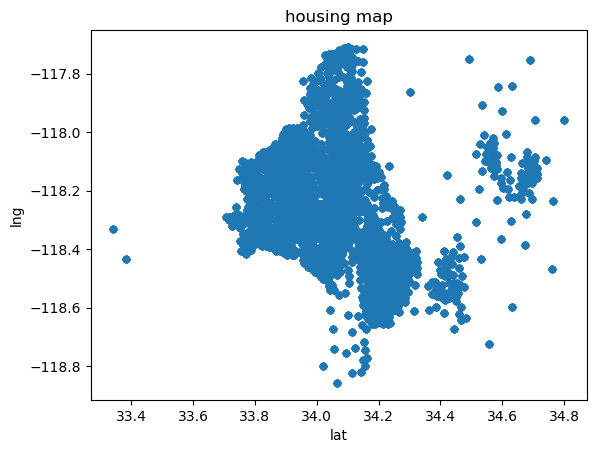

In [48]:
#still nothing. Maybe if I make some arguments
housing.plot.scatter(x = 'lat', y = 'lng', title = 'housing map')

In [44]:
#Looks like a lot of values overlap
housing.value_counts()

Count  tractnumber  neighborhood               lat          lng           
0      980003       Northeast Antelope Valley  34.80048881   -117.95741244    10
       980025       Carson                     33.84299739   -118.23867802    10
       980022       Granada Hills              34.29918558   -118.48544196    10
       980030       El Segundo                 33.90969343   -118.41070890    10
       980020       Shadow Hills               34.22669419   -118.30341525    10
                                                                              ..
1215   187102       Glassell Park              34.09656480   -118.23473325     1
       186201       Eagle Rock                 34.12316126   -118.22151276     1
1214   571704       Long Beach                 33.84995065   -118.18708450     1
       570204       Long Beach                 33.87163769   -118.15562507     1
7210   702901       Marina del Rey             33.97649933   -118.44859964     1
Length: 22006, dtype: int64

In [49]:
#Seems so. Let's try mapping now 
import folium
m = folium.map
m

<module 'folium.map' from '/opt/conda/lib/python3.10/site-packages/folium/map.py'>

In [50]:
# Calculate average latitude
latitude = housing.lat.mean()
latitude

34.06578168920045

In [51]:
#Calculate average longitude
longitude = housing.lng.mean()
longitude

-118.2517813726845

In [66]:
#now let's apply those averages to the view of the folium map and have it plot some points
m = folium.Map(location=[latitude,longitude])
for index, row in housing.iterrows():
    # add folium marker code
     folium.Marker([row.lat, row.lng], popup=row.neighborhood, tooltip=row.neighborhood).add_to(m)
m

In [ ]:
# mama mia that's a lot of markers. Looking forward to learning the arguments for creating clusters and doing overlays with shapefiles! 